# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from kaggle that contains information on 3 million used cars.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary. 

### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

In [41]:
import pandas as pd
df = pd.read_csv('data/vehicles.csv')

In [42]:
df.isnull().sum()

id                   0
region               0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
VIN             161042
drive           130567
size            306361
type             92858
paint_color     130203
state                0
dtype: int64

In [43]:
df = df.dropna()

In [44]:
df['cylinders'] = df['cylinders'].replace("[cylinders,]","",regex=True)
df['cylinders'].unique()

array(['6 ', '4 ', '8 ', '5 ', '10 ', '3 ', 'oth', '12 '], dtype=object)

In [45]:
df = df[df["cylinders"].str.contains("oth") == False]
df['cylinders'].unique().astype(int)

array([ 6,  4,  8,  5, 10,  3, 12])

In [46]:
df['year'] = df['year'].astype(int)
df['odometer'] = df['odometer'].astype(int)

In [47]:
df

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
126,7305672709,auburn,0,2018,chevrolet,express cargo van,like new,6,gas,68472,clean,automatic,1GCWGAFP8J1309579,rwd,full-size,van,white,al
127,7305672266,auburn,0,2019,chevrolet,express cargo van,like new,6,gas,69125,clean,automatic,1GCWGAFP4K1214373,rwd,full-size,van,white,al
128,7305672252,auburn,0,2018,chevrolet,express cargo van,like new,6,gas,66555,clean,automatic,1GCWGAFPXJ1337903,rwd,full-size,van,white,al
215,7316482063,birmingham,4000,2002,toyota,echo,excellent,4,gas,155000,clean,automatic,JTDBT123520243495,fwd,compact,sedan,blue,al
219,7316429417,birmingham,2500,1995,bmw,525i,fair,6,gas,110661,clean,automatic,WBAHD6322SGK86772,rwd,mid-size,sedan,white,al
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426788,7303227528,wyoming,12995,2016,chevrolet,cruze lt,like new,4,gas,61127,clean,automatic,1G1BE5SM0G7266569,fwd,compact,sedan,silver,wy
426792,7303114896,wyoming,32999,2014,ford,"f350, xlt",excellent,8,diesel,154642,clean,automatic,1FT8W3DT3EEB41548,4wd,full-size,pickup,brown,wy
426793,7303112347,wyoming,15999,2018,chevrolet,"cruze, lt",excellent,4,gas,36465,clean,automatic,1G1BE5SM7J7133704,fwd,mid-size,sedan,black,wy
426833,7302338378,wyoming,6800,1997,jaguar,xk8 convertible,good,8,gas,69550,clean,automatic,SAJGX2749VCOO8376,rwd,compact,convertible,white,wy


In [48]:
df.corr()

,id,price,year,odometer
id,1.000000,-0.049700,-0.069765,0.028673
price,-0.049700,1.000000,0.254417,-0.199887
year,-0.069765,0.254417,1.000000,-0.220968
odometer,0.028673,-0.199887,-0.220968,1.000000


In [49]:
#Checking the price values for the car; Removed all cars with less $1000
df = df[df.price > 1000]
#Checking the odometer values for the cars; Removed all cars with more that 1M miles
df = df[df.odometer < 1_000_000]
df

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
215,7316482063,birmingham,4000,2002,toyota,echo,excellent,4,gas,155000,clean,automatic,JTDBT123520243495,fwd,compact,sedan,blue,al
219,7316429417,birmingham,2500,1995,bmw,525i,fair,6,gas,110661,clean,automatic,WBAHD6322SGK86772,rwd,mid-size,sedan,white,al
268,7315946365,birmingham,9000,2008,mazda,miata mx-5,excellent,4,gas,56700,clean,automatic,JM1NC25F570128735,rwd,compact,convertible,white,al
337,7315354216,birmingham,8950,2011,ford,f-150,excellent,6,gas,164000,clean,automatic,1FTMF1CM6BKD55331,fwd,full-size,truck,white,al
338,7315349921,birmingham,4000,1972,mercedes-benz,benz,fair,6,gas,88100,clean,automatic,1.14023E+13,rwd,full-size,coupe,silver,al
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426785,7303314912,wyoming,23495,2015,ford,f150 xlt 4x4,like new,8,gas,146795,clean,automatic,1FTFX1EF5FFC24427,4wd,full-size,truck,black,wy
426788,7303227528,wyoming,12995,2016,chevrolet,cruze lt,like new,4,gas,61127,clean,automatic,1G1BE5SM0G7266569,fwd,compact,sedan,silver,wy
426792,7303114896,wyoming,32999,2014,ford,"f350, xlt",excellent,8,diesel,154642,clean,automatic,1FT8W3DT3EEB41548,4wd,full-size,pickup,brown,wy
426793,7303112347,wyoming,15999,2018,chevrolet,"cruze, lt",excellent,4,gas,36465,clean,automatic,1G1BE5SM7J7133704,fwd,mid-size,sedan,black,wy


[(0.0, 100000.0)]

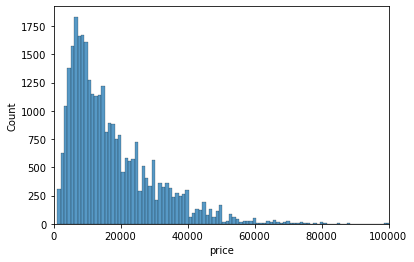

In [50]:
import seaborn as sns
a_plot = sns.histplot(data=df, x= 'price')
a_plot. set(xlim=(0, 100000))

In [51]:
df.corr()

,id,price,year,odometer
id,1.000000,-0.071397,-0.064324,0.042578
price,-0.071397,1.000000,0.344002,-0.425551
year,-0.064324,0.344002,1.000000,-0.280096
odometer,0.042578,-0.425551,-0.280096,1.000000


In [12]:
import plotly.express as px
fig = px.scatter(df, x="price", y="year", trendline="ols")
fig.show()

[(1900.0, 2020.0)]

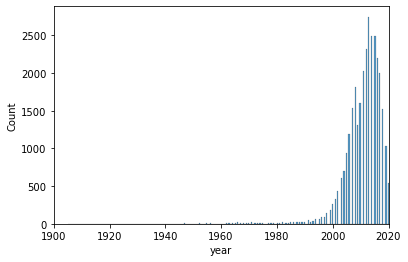

In [13]:
a_plot = sns.histplot(data=df, x= 'year')
a_plot. set(xlim=(1900, 2020))

[(0.0, 400000.0)]

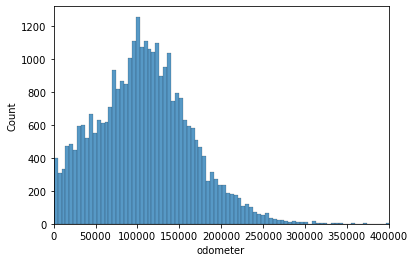

In [14]:
a_plot = sns.histplot(data=df, x= 'odometer')
a_plot. set(xlim=(0, 400000))

In [15]:
fig = px.scatter(df, x="year", y="price", color = "odometer", trendline="ols")
fig.show()

In [16]:
print(df['price'].median())
print(df['year'].median())
print(df['odometer'].median())

13900.0
2012.0
107000.0


In [17]:
state = pd.DataFrame(df['state'].value_counts())
fig = px.histogram(state, x=state.index, y='state', text_auto=True , title = 'Cars by State' )
fig.show()

In [18]:
manufacturer = pd.DataFrame(df['manufacturer'].value_counts())
fig = px.histogram(manufacturer, x=manufacturer.index, y='manufacturer', text_auto=True , title = 'Cars by Manufacturer' )
fig.show()

In [19]:
fig = px.scatter(df, x="odometer", y="price", trendline="ols")
fig.show()

In [20]:
fig = px.box(df, x="condition", y="price")
fig.show()

In [21]:
fig = px.box(df, x="cylinders", y="price")
fig.show()

In [22]:
fig = px.box(df, x="size", y="price")
fig.show()

In [23]:
fig = px.box(df, x="type", y="price")
fig.show()

In [24]:
fig = px.box(df, x="fuel", y="price")
fig.show()

In [25]:
fig = px.box(df, x="drive", y="price")
fig.show()

### Data Preparation

After our initial exploration and fine tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`. 

In [26]:
#One hot-encoding


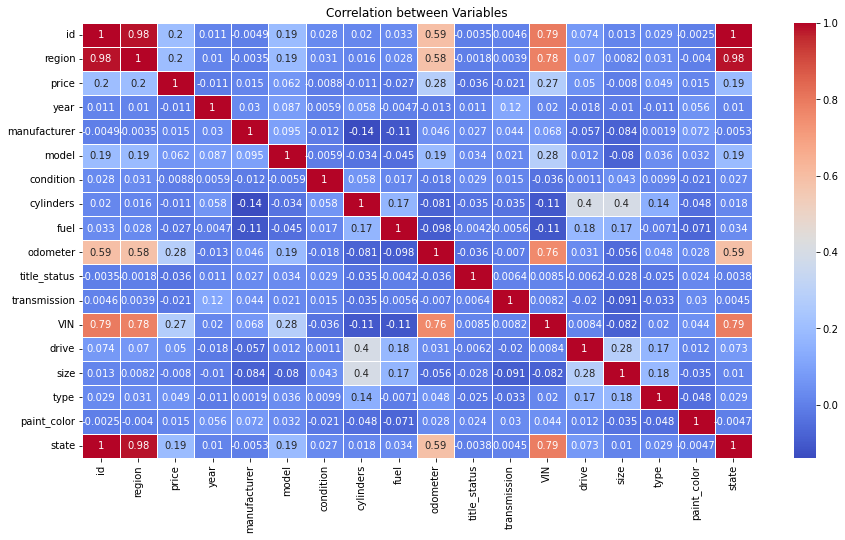

In [27]:
import matplotlib.pyplot as plt

#Use pandas.factorize() method which can get the numeric representation of an array by identifying distinct values.
temp_df = df.apply(lambda x: x.factorize()[0]).corr()
plt.figure(figsize=(15,8))
plt.title("Correlation between Variables")
sns.heatmap(temp_df, linewidths=0.5, cmap="coolwarm", annot=True)
plt.show()

In [28]:
#I've just realize that the VIN number carries a lot of information regarding the vehicle.

In [52]:
from sklearn.preprocessing import LabelEncoder
# creating an instance of labelencoder
labelencoder = LabelEncoder()
# Assigning numerical values and storing it in another column called "State N'
df["state_cat"] = labelencoder.fit_transform(df["state"])
# Display Dataframe
df["state_cat"] = df["state_cat"].astype('category')
df.dtypes
df

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state,state_cat
215,7316482063,birmingham,4000,2002,toyota,echo,excellent,4,gas,155000,clean,automatic,JTDBT123520243495,fwd,compact,sedan,blue,al,1
219,7316429417,birmingham,2500,1995,bmw,525i,fair,6,gas,110661,clean,automatic,WBAHD6322SGK86772,rwd,mid-size,sedan,white,al,1
268,7315946365,birmingham,9000,2008,mazda,miata mx-5,excellent,4,gas,56700,clean,automatic,JM1NC25F570128735,rwd,compact,convertible,white,al,1
337,7315354216,birmingham,8950,2011,ford,f-150,excellent,6,gas,164000,clean,automatic,1FTMF1CM6BKD55331,fwd,full-size,truck,white,al,1
338,7315349921,birmingham,4000,1972,mercedes-benz,benz,fair,6,gas,88100,clean,automatic,1.14023E+13,rwd,full-size,coupe,silver,al,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426785,7303314912,wyoming,23495,2015,ford,f150 xlt 4x4,like new,8,gas,146795,clean,automatic,1FTFX1EF5FFC24427,4wd,full-size,truck,black,wy,50
426788,7303227528,wyoming,12995,2016,chevrolet,cruze lt,like new,4,gas,61127,clean,automatic,1G1BE5SM0G7266569,fwd,compact,sedan,silver,wy,50
426792,7303114896,wyoming,32999,2014,ford,"f350, xlt",excellent,8,diesel,154642,clean,automatic,1FT8W3DT3EEB41548,4wd,full-size,pickup,brown,wy,50
426793,7303112347,wyoming,15999,2018,chevrolet,"cruze, lt",excellent,4,gas,36465,clean,automatic,1G1BE5SM7J7133704,fwd,mid-size,sedan,black,wy,50


In [59]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge, RidgeCV, Lasso, LinearRegression
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split

X, y = df[['year','odometer','state_cat']], df['price']

ss = StandardScaler()
lr = LinearRegression()

pipe = Pipeline([('scaler', ss),
                 ('linear', lr)])

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=123)

pipe.fit(X_train,y_train)
pipe.score(X_test,y_test)

0.249560258749425

In [57]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

model = make_pipeline(StandardScaler(), RidgeCV())

model.fit(X_train, y_train)

print(f'model score on training data: {model.score(X_train, y_train)}')
print(f'model score on testing data: {model.score(X_test, y_test)}')

model score on training data: 0.2300688000603005
model score on testing data: 0.24955796177709288


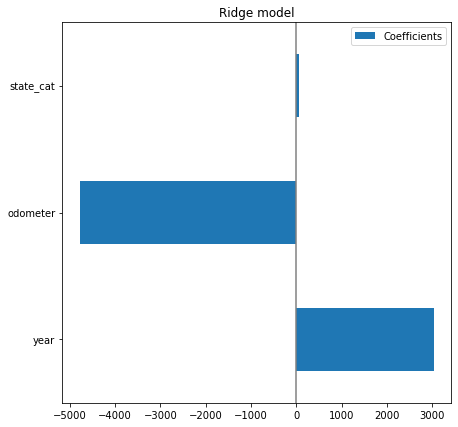

In [32]:
coefs = pd.DataFrame(
   model[1].coef_,
   columns=['Coefficients'], index=X_train.columns
)

coefs.plot(kind='barh', figsize=(9, 7))
plt.title('Ridge model')
plt.axvline(x=0, color='.5')
plt.subplots_adjust(left=.3)

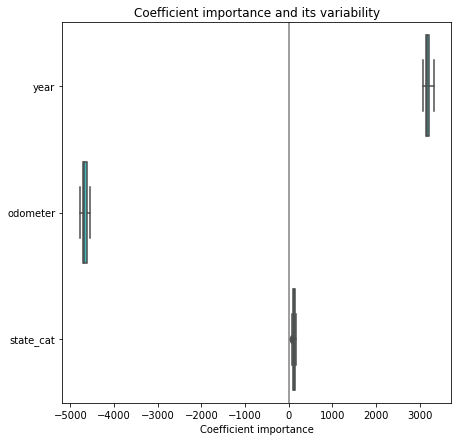

In [37]:
from sklearn.model_selection import cross_validate
from sklearn.model_selection import RepeatedKFold

feature_names = ['year','odometer','state_cat']

cv_model = cross_validate(
   model, X, y, cv=RepeatedKFold(n_splits=5, n_repeats=5),
   return_estimator=True, n_jobs=2
)

coefs = pd.DataFrame(
   [model[1].coef_
    for model in cv_model['estimator']],
   columns=feature_names
)
plt.figure(figsize=(9, 7))
sns.boxplot(data=coefs, orient='h', color='cyan', saturation=0.5)
plt.axvline(x=0, color='.5')
plt.xlabel('Coefficient importance')
plt.title('Coefficient importance and its variability')
plt.subplots_adjust(left=.3)

In [60]:
from sklearn.preprocessing import LabelEncoder
# creating an instance of labelencoder
labelencoder = LabelEncoder()
# Assigning numerical values and storing it in another column called "State N'
df["type_cat"] = labelencoder.fit_transform(df["type"])
# Display Dataframe
df["type_cat"] = df["type_cat"].astype('category')
df.dtypes
df

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state,state_cat,type_cat
215,7316482063,birmingham,4000,2002,toyota,echo,excellent,4,gas,155000,clean,automatic,JTDBT123520243495,fwd,compact,sedan,blue,al,1,9
219,7316429417,birmingham,2500,1995,bmw,525i,fair,6,gas,110661,clean,automatic,WBAHD6322SGK86772,rwd,mid-size,sedan,white,al,1,9
268,7315946365,birmingham,9000,2008,mazda,miata mx-5,excellent,4,gas,56700,clean,automatic,JM1NC25F570128735,rwd,compact,convertible,white,al,1,2
337,7315354216,birmingham,8950,2011,ford,f-150,excellent,6,gas,164000,clean,automatic,1FTMF1CM6BKD55331,fwd,full-size,truck,white,al,1,10
338,7315349921,birmingham,4000,1972,mercedes-benz,benz,fair,6,gas,88100,clean,automatic,1.14023E+13,rwd,full-size,coupe,silver,al,1,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
426785,7303314912,wyoming,23495,2015,ford,f150 xlt 4x4,like new,8,gas,146795,clean,automatic,1FTFX1EF5FFC24427,4wd,full-size,truck,black,wy,50,10
426788,7303227528,wyoming,12995,2016,chevrolet,cruze lt,like new,4,gas,61127,clean,automatic,1G1BE5SM0G7266569,fwd,compact,sedan,silver,wy,50,9
426792,7303114896,wyoming,32999,2014,ford,"f350, xlt",excellent,8,diesel,154642,clean,automatic,1FT8W3DT3EEB41548,4wd,full-size,pickup,brown,wy,50,8
426793,7303112347,wyoming,15999,2018,chevrolet,"cruze, lt",excellent,4,gas,36465,clean,automatic,1G1BE5SM7J7133704,fwd,mid-size,sedan,black,wy,50,9


In [61]:
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge, RidgeCV, Lasso, LinearRegression
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split

X, y = df[['year','odometer','state_cat', 'type_cat']], df['price']

ss = StandardScaler()
lr = LinearRegression()

pipe = Pipeline([('scaler', ss),
                 ('linear', lr)])

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=123)

pipe.fit(X_train,y_train)
pipe.score(X_test,y_test)

0.27040320612874225

In [62]:
model = make_pipeline(StandardScaler(), RidgeCV())

model.fit(X_train, y_train)

print(f'model score on training data: {model.score(X_train, y_train)}')
print(f'model score on testing data: {model.score(X_test, y_test)}')

model score on training data: 0.24916764103571887
model score on testing data: 0.27040137862417923


In [66]:
from sklearn.preprocessing import LabelEncoder
# creating an instance of labelencoder
labelencoder = LabelEncoder()
# Assigning numerical values and storing it in another column called "State N'
df["manufacturer_cat"] = labelencoder.fit_transform(df["manufacturer"])
# Display Dataframe
df["manufacturer_cat"] = df["manufacturer_cat"].astype('category')
df.dtypes
df

id                     int64
region                object
price                  int64
year                   int64
manufacturer          object
model                 object
condition             object
cylinders             object
fuel                  object
odometer               int64
title_status          object
transmission          object
VIN                   object
drive                 object
size                  object
type                  object
paint_color           object
state                 object
state_cat           category
type_cat            category
manufacturer_cat    category
dtype: object

In [64]:
X, y = df[['year','odometer','state_cat', 'type_cat', 'manufacturer_cat']], df['price']

ss = StandardScaler()
lr = LinearRegression()

pipe = Pipeline([('scaler', ss),
                 ('linear', lr)])

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=123)

pipe.fit(X_train,y_train)
pipe.score(X_test,y_test)

0.2753861034135112

In [65]:
model = make_pipeline(StandardScaler(), RidgeCV())

model.fit(X_train, y_train)

print(f'model score on training data: {model.score(X_train, y_train)}')
print(f'model score on testing data: {model.score(X_test, y_test)}')

model score on training data: 0.25528017681350623
model score on testing data: 0.2753853324993287


In [247]:
#Check based on State

features = ['odometer', 'state']

features_data = pd.DataFrame(df[features])
dummies = pd.get_dummies(features_data.state, prefix='state')
state_dummies = pd.concat([features_data,dummies], axis=1)
del state_dummies['state']
state_dummies.head()

,odometer,state_ak,state_al,state_ar,state_az,state_ca,state_co,state_ct,state_dc,state_de,...,state_sd,state_tn,state_tx,state_ut,state_va,state_vt,state_wa,state_wi,state_wv,state_wy
215,155000,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
219,110661,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
268,56700,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
337,164000,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
338,88100,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [248]:
import sklearn
from sklearn import linear_model
f_with_state = linear_model.LinearRegression(fit_intercept=False)
f_with_state.fit(state_dummies, df['price'])
state_coef = pd.DataFrame(f_with_state.coef_, index=[state_dummies.columns.values.tolist()], columns=['coef'])
state_coef.sort_values(by='coef')

,coef
odometer,-0.094003
state_dc,21958.692937
state_pa,23162.066174
state_nj,23609.754158
state_oh,24555.193065
state_or,25216.461265
state_nh,25247.215618
state_ct,25264.898494
state_nv,25281.669894
state_az,25471.960559


In [249]:
#Check based on Manufacturer
features = ['odometer', 'manufacturer']

features_data = pd.DataFrame(df[features])
dummies = pd.get_dummies(features_data.manufacturer, prefix='brand')
manufacturer_dummies = pd.concat([features_data,dummies], axis=1)
del manufacturer_dummies['manufacturer']
manufacturer_dummies.head()

,odometer,brand_acura,brand_alfa-romeo,brand_aston-martin,brand_audi,brand_bmw,brand_buick,brand_cadillac,brand_chevrolet,brand_chrysler,...,brand_pontiac,brand_porsche,brand_ram,brand_rover,brand_saturn,brand_subaru,brand_tesla,brand_toyota,brand_volkswagen,brand_volvo
215,155000,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
219,110661,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
268,56700,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
337,164000,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
338,88100,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [250]:
f_with_manufacturer = linear_model.LinearRegression(fit_intercept=False)
f_with_manufacturer.fit(manufacturer_dummies, df['price'])
brand_coef = pd.DataFrame(f_with_manufacturer.coef_, index=[manufacturer_dummies.columns.values.tolist()], columns=['coef'])
brand_coef.sort_values(by='coef')

,coef
odometer,-0.096808
brand_land rover,16128.898443
brand_fiat,16436.232771
brand_saturn,16480.139602
brand_mercury,18103.384716
brand_mini,19087.212127
brand_hyundai,19615.995467
brand_kia,19651.106314
brand_chrysler,19923.042642
brand_volkswagen,20279.808537


### Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight on drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine tuning their inventory.